In [4]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import re
import math
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        
        
train = pd.read_csv('/kaggle/input/web-traffic-time-series-forecasting/train_1.csv.zip')
train.shape

/kaggle/input/web-traffic-time-series-forecasting/sample_submission_2.csv.zip
/kaggle/input/web-traffic-time-series-forecasting/sample_submission_1.csv.zip
/kaggle/input/web-traffic-time-series-forecasting/train_2.csv.zip
/kaggle/input/web-traffic-time-series-forecasting/key_1.csv.zip
/kaggle/input/web-traffic-time-series-forecasting/key_2.csv.zip
/kaggle/input/web-traffic-time-series-forecasting/train_1.csv.zip


(145063, 551)

In [6]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145063 entries, 0 to 145062
Columns: 551 entries, Page to 2016-12-31
dtypes: float64(550), object(1)
memory usage: 609.8+ MB


In [7]:
def get_language(page):
    res = re.search('[a-z][a-z].wikipedia.org',page)
    if res:
        return res[0][0:2]
    return 'na'

train['lang'] = train.Page.map(get_language)

from collections import Counter
print(Counter(train.lang))

Counter({'en': 24108, 'ja': 20431, 'de': 18547, 'na': 17855, 'fr': 17802, 'zh': 17229, 'ru': 15022, 'es': 14069})


In [8]:
lang_sets = {}
lang_sets['en'] = train[train.lang=='en'].iloc[:,0:-1]
lang_sets['ja'] = train[train.lang=='ja'].iloc[:,0:-1]
lang_sets['de'] = train[train.lang=='de'].iloc[:,0:-1]
lang_sets['na'] = train[train.lang=='na'].iloc[:,0:-1]
lang_sets['fr'] = train[train.lang=='fr'].iloc[:,0:-1]
lang_sets['zh'] = train[train.lang=='zh'].iloc[:,0:-1]
lang_sets['ru'] = train[train.lang=='ru'].iloc[:,0:-1]
lang_sets['es'] = train[train.lang=='es'].iloc[:,0:-1]

sums = {}
for key in lang_sets:
    sums[key] = lang_sets[key].iloc[:,1:].sum(axis=0) / lang_sets[key].shape[0]

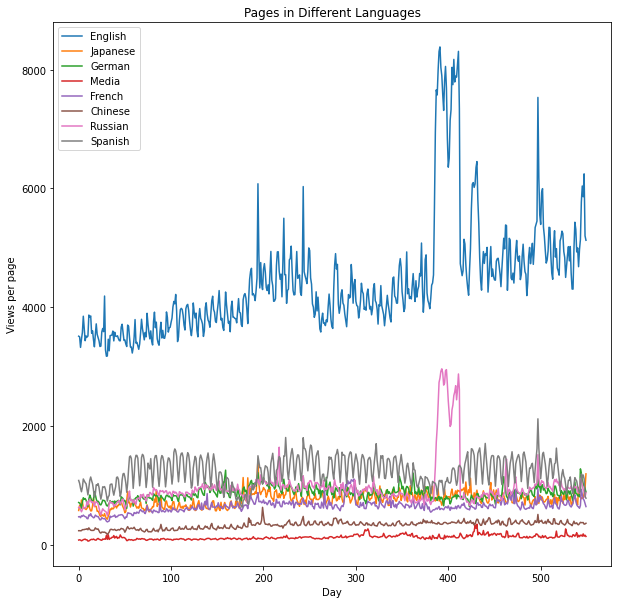

In [9]:
import matplotlib.pyplot as plt
days = [r for r in range(sums['en'].shape[0])]

fig = plt.figure(1,figsize=[10,10])
plt.ylabel('Views per page')
plt.xlabel('Day')
plt.title('Pages in Different Languages')
labels = {'en' : 'English','ja' : 'Japanese','de':'German',
         'na' : 'Media','fr': 'French','zh':'Chinese','ru':'Russian','es':'Spanish'}

for key in sums:
    plt.plot(days,sums[key],label = labels[key])
    
    
plt.legend()
plt.show()

## Periodic Structure and FFTs

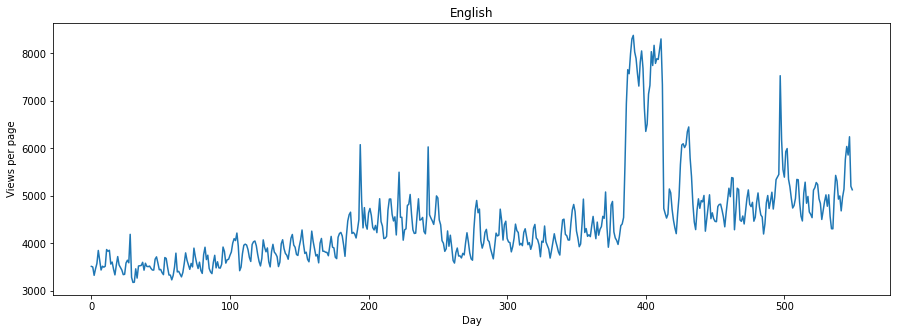

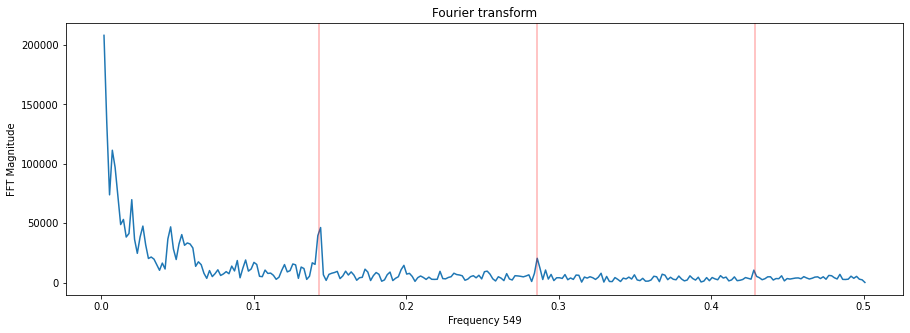

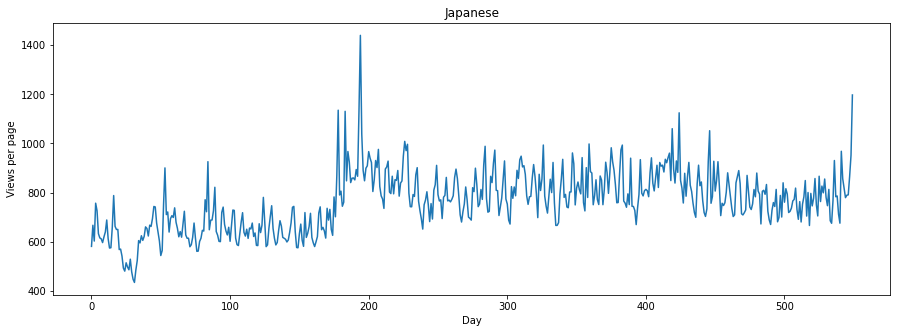

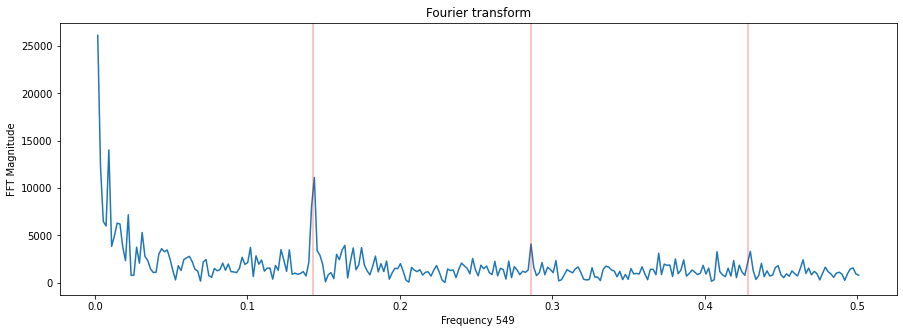

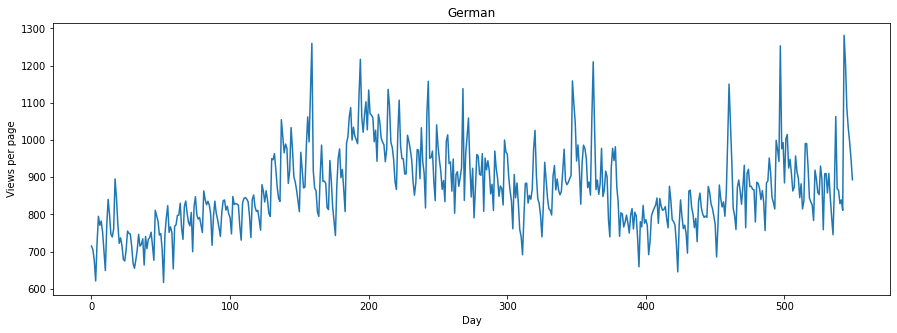

...

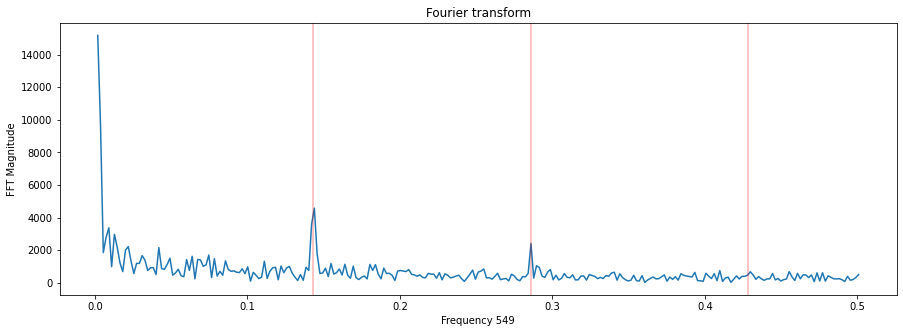

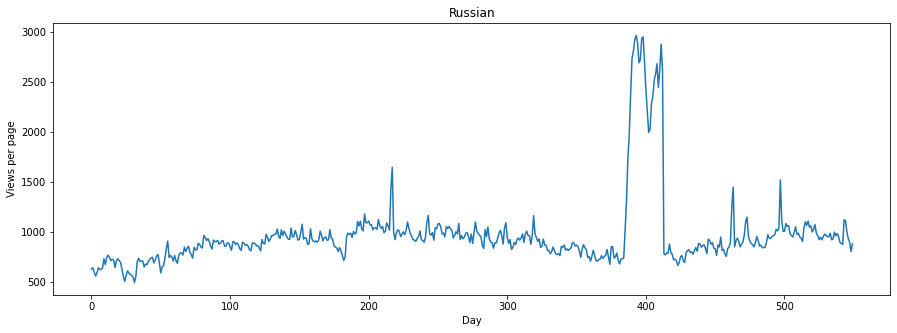

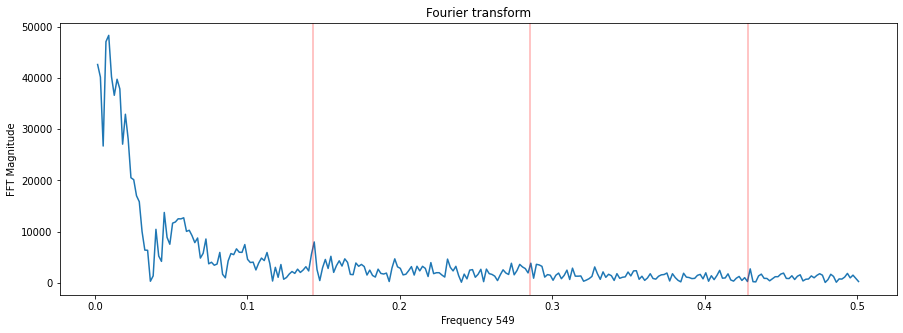

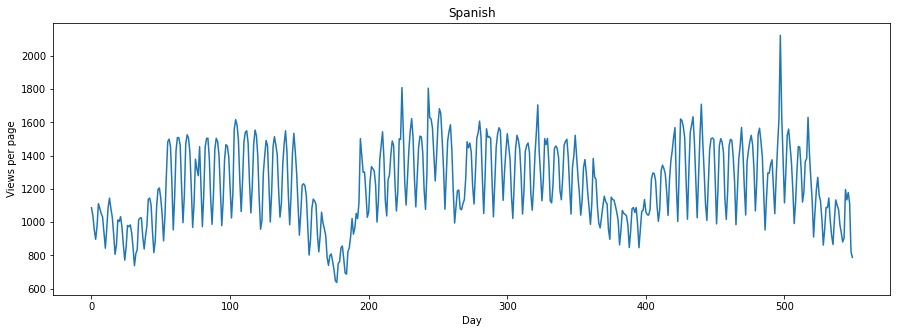

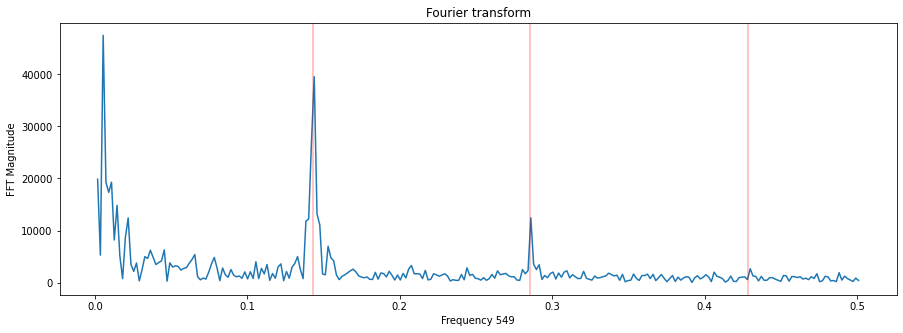

In [10]:
from scipy.fftpack import fft

def plot_with_fft(key):
    
    fig = plt.figure(1,figsize=[15,5])
    plt.ylabel('Views per page')
    plt.xlabel('Day')
    plt.title(labels[key])
    plt.plot(days,sums[key], label = labels[key])
    
    
    fig = plt.figure(2,figsize=[15,5])
    fft_complex = fft(sums[key].values)
    fft_mag = [np.sqrt(np.real(x)*np.real(x)+np.imag(x)*np.imag(x)) for x in fft_complex]
    fft_xvals = [day / days[-1] for day in days]
    npts = len(fft_xvals) // 2 + 1
    fft_mag = fft_mag[:npts]
    fft_xvals = fft_xvals[:npts]
    
    plt.ylabel('FFT Magnitude')
    plt.xlabel(f'Frequency {days[-1]}')
    plt.title('Fourier transform')
    plt.plot(fft_xvals[1:],fft_mag[1:],label = labels[key])
    
    plt.axvline(x=1./7,color='red',alpha = 0.3)
    plt.axvline(x=2./7,color='red',alpha = 0.3)
    plt.axvline(x=3./7,color='red',alpha = 0.3)
    
    plt.show()
    
for key in sums:
    plot_with_fft(key)

## Individual Entries

In [11]:
def plot_entry(key,idx):
    data = lang_sets[key].iloc[idx,1:]
    fig = plt.figure(1,figsize=(10,5))
    plt.plot(days,data)
    plt.xlabel('day')
    plt.ylabel('views')
    plt.title(train.iloc[lang_sets[key].index[idx],0])
    
    plt.show()

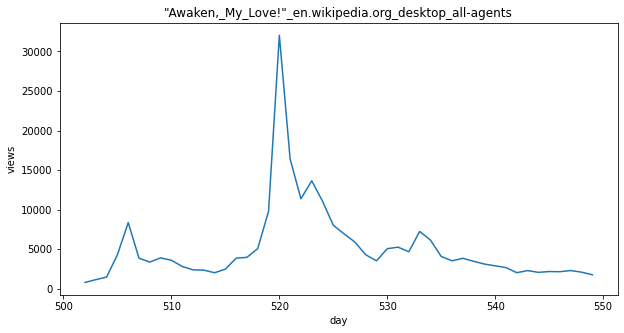

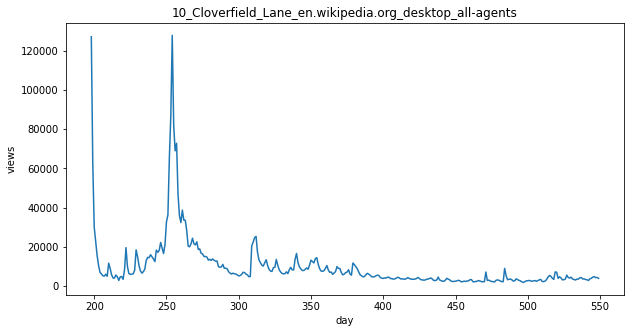

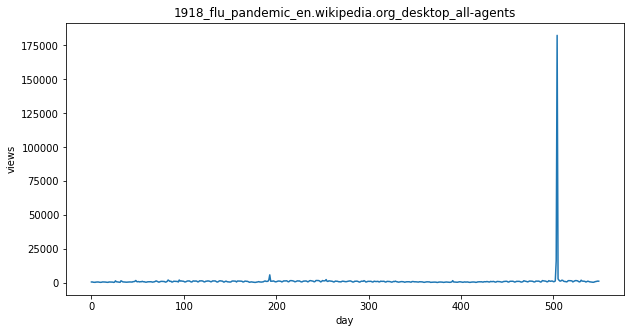

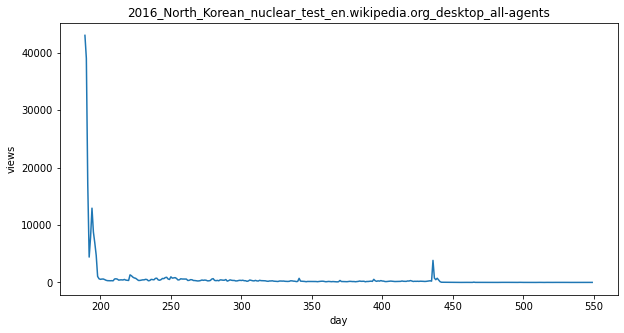

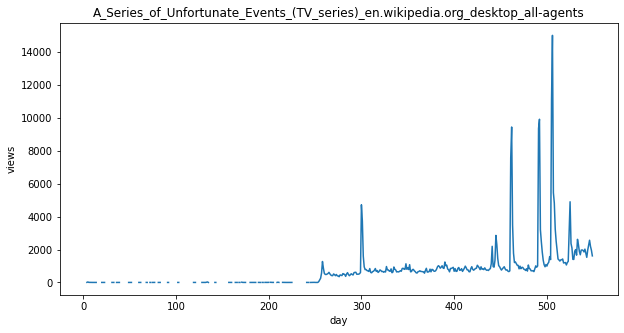

...

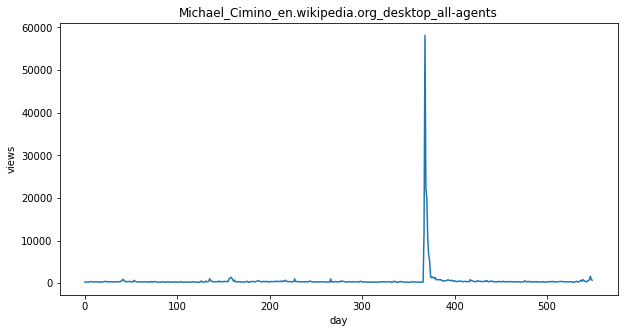

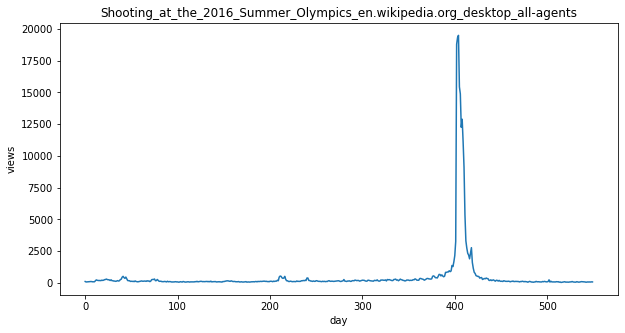

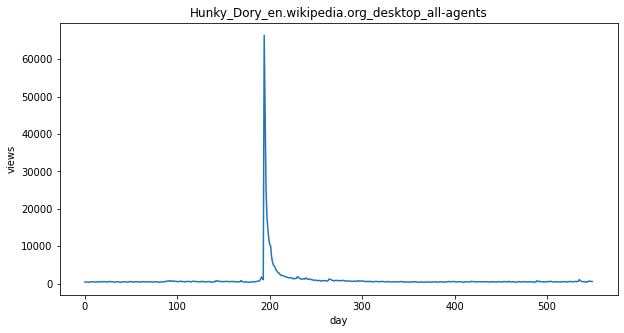

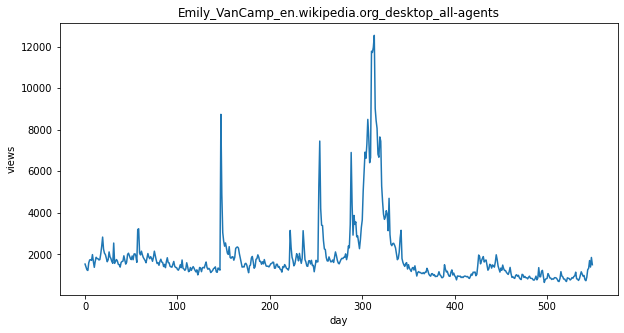

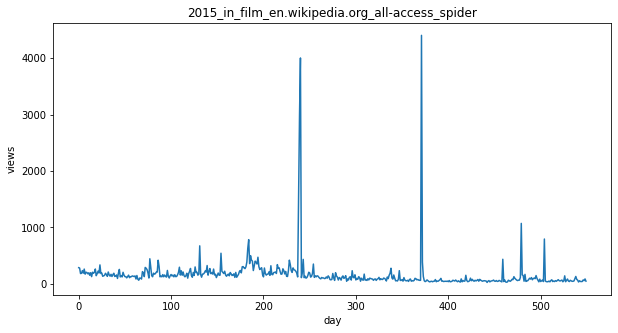

In [12]:
idx = [1,5,10,50,100,250,500,750,1000,1500,2000,3000,4000,5000]

for i in idx:
    plot_entry('en',i)

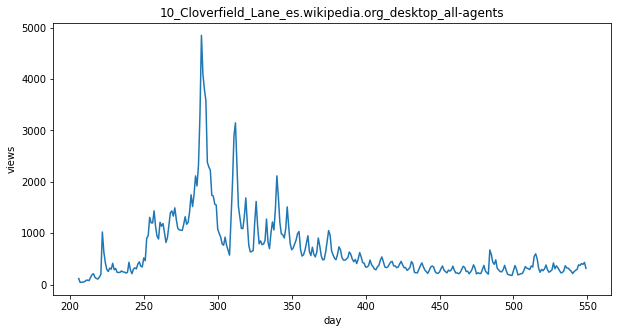

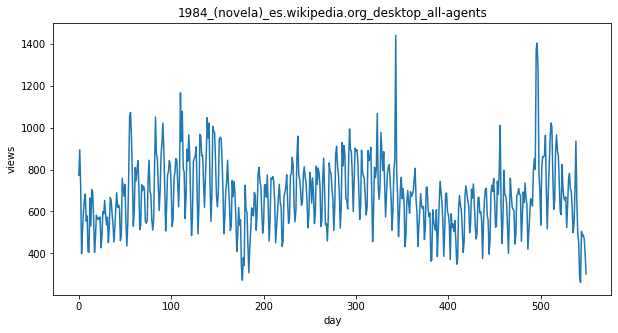

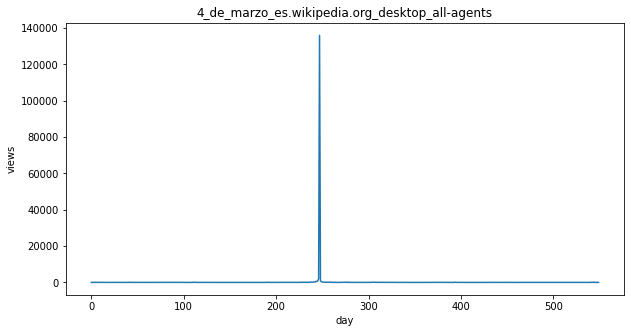

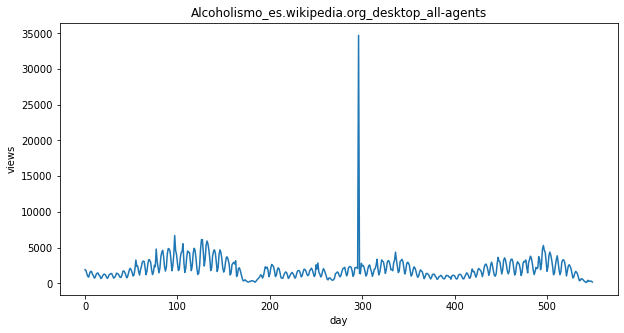

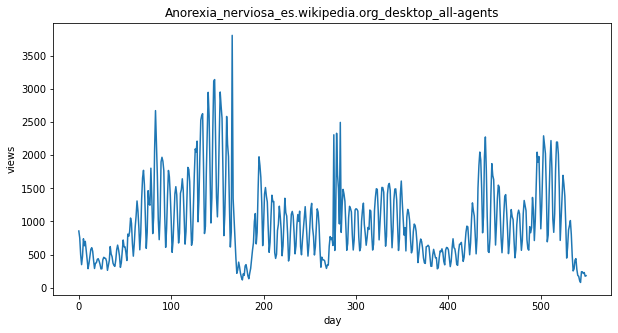

...

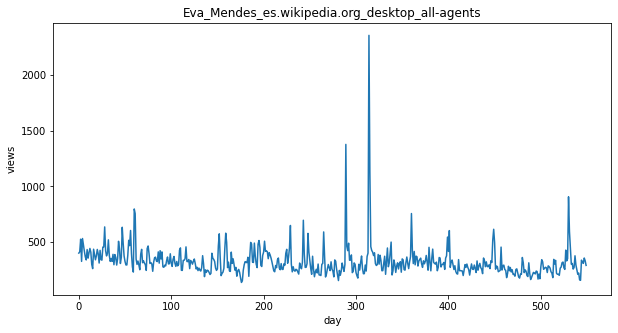

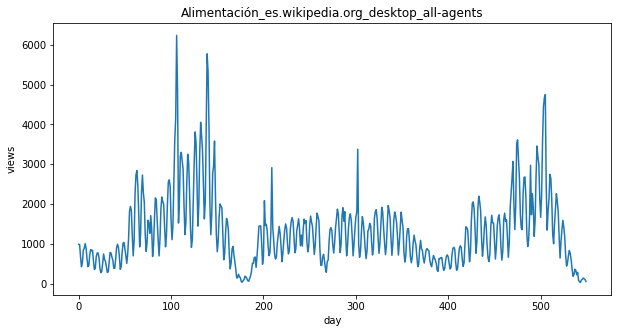

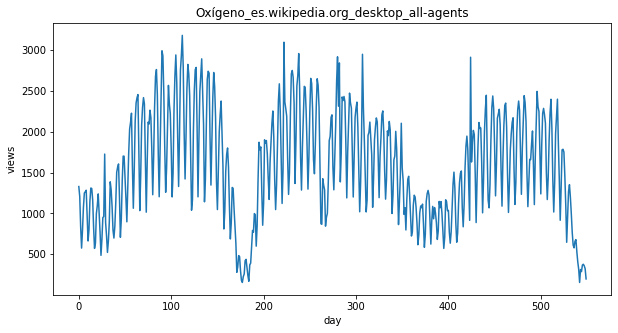

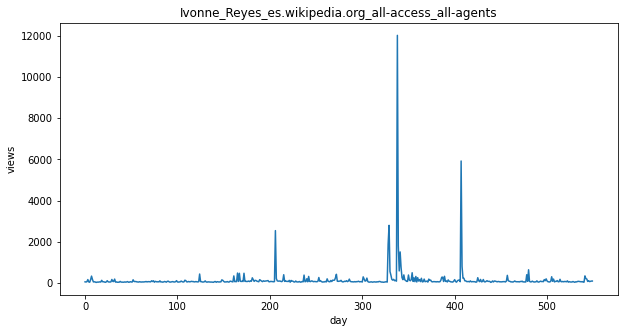

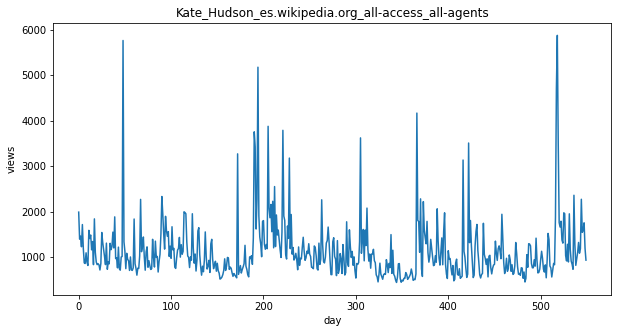

In [13]:
idx = [1,5,10,50,100,250,500,750,1000,1500,2000,3000,4000,5000]

for i in idx:
    plot_entry('es',i)

## Aggregated Data Compared to Popular pages

In [14]:
npages = 5
top_pages = {}
for key in lang_sets:
    print(key)
    sum_set = pd.DataFrame(lang_sets[key]['Page'])
    sum_set['total'] = lang_sets[key].sum(axis=1)
    sum_set = sum_set.sort_values('total',ascending=False)
    print(sum_set.head(10))
    top_pages[key] = sum_set.index[0]
    print('\n\n')
    
    

en


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                    Page         total
38573   Main_Page_en.wikipedia.org_all-access_all-agents  1.206618e+10
9774       Main_Page_en.wikipedia.org_desktop_all-agents  8.774497e+09
74114   Main_Page_en.wikipedia.org_mobile-web_all-agents  3.153985e+09
39180  Special:Search_en.wikipedia.org_all-access_all...  1.304079e+09
10403  Special:Search_en.wikipedia.org_desktop_all-ag...  1.011848e+09
74690  Special:Search_en.wikipedia.org_mobile-web_all...  2.921628e+08
39172  Special:Book_en.wikipedia.org_all-access_all-a...  1.339931e+08
10399   Special:Book_en.wikipedia.org_desktop_all-agents  1.332859e+08
33644       Main_Page_en.wikipedia.org_all-access_spider  1.290204e+08
34257  Special:Search_en.wikipedia.org_all-access_spider  1.243102e+08



ja


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                     Page        total
120336      メインページ_ja.wikipedia.org_all-access_all-agents  210753795.0
86431          メインページ_ja.wikipedia.org_desktop_all-agents  134147415.0
123025       特別:検索_ja.wikipedia.org_all-access_all-agents   70316929.0
89202           特別:検索_ja.wikipedia.org_desktop_all-agents   69215206.0
57309       メインページ_ja.wikipedia.org_mobile-web_all-agents   66459122.0
119609    特別:最近の更新_ja.wikipedia.org_all-access_all-agents   17662791.0
88897        特別:最近の更新_ja.wikipedia.org_desktop_all-agents   17627621.0
119625        真田信繁_ja.wikipedia.org_all-access_all-agents   10793039.0
123292  特別:外部リンク検索_ja.wikipedia.org_all-access_all-agents   10331191.0
89463      特別:外部リンク検索_ja.wikipedia.org_desktop_all-agents   10327917.0



de


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                     Page         total
139119  Wikipedia:Hauptseite_de.wikipedia.org_all-acce...  1.603934e+09
116196  Wikipedia:Hauptseite_de.wikipedia.org_mobile-w...  1.112689e+09
67049   Wikipedia:Hauptseite_de.wikipedia.org_desktop_...  4.269924e+08
140151  Spezial:Suche_de.wikipedia.org_all-access_all-...  2.234259e+08
66736   Spezial:Suche_de.wikipedia.org_desktop_all-agents  2.196368e+08
140147  Spezial:Anmelden_de.wikipedia.org_all-access_a...  4.029181e+07
138800  Special:Search_de.wikipedia.org_all-access_all...  3.988154e+07
68104   Spezial:Anmelden_de.wikipedia.org_desktop_all-...  3.535523e+07
68511   Special:MyPage/toolserverhelferleinconfig.js_d...  3.258496e+07
137765  Hauptseite_de.wikipedia.org_all-access_all-agents  3.173246e+07



na


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                    Page       total
45071  Special:Search_commons.wikimedia.org_all-acces...  67150638.0
81665  Special:Search_commons.wikimedia.org_desktop_a...  63349756.0
45056  Special:CreateAccount_commons.wikimedia.org_al...  53795386.0
45028  Main_Page_commons.wikimedia.org_all-access_all...  52732292.0
81644  Special:CreateAccount_commons.wikimedia.org_de...  48061029.0
81610  Main_Page_commons.wikimedia.org_desktop_all-ag...  39160923.0
46078  Special:RecentChangesLinked_commons.wikimedia....  28306336.0
45078  Special:UploadWizard_commons.wikimedia.org_all...  23733805.0
81671  Special:UploadWizard_commons.wikimedia.org_des...  22008544.0
82680  Special:RecentChangesLinked_commons.wikimedia....  21915202.0



fr


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                     Page        total
27330   Wikipédia:Accueil_principal_fr.wikipedia.org_a...  868480667.0
55104   Wikipédia:Accueil_principal_fr.wikipedia.org_m...  611302821.0
7344    Wikipédia:Accueil_principal_fr.wikipedia.org_d...  239589012.0
27825   Spécial:Recherche_fr.wikipedia.org_all-access_...   95666374.0
8221    Spécial:Recherche_fr.wikipedia.org_desktop_all...   88448938.0
26500   Sp?cial:Search_fr.wikipedia.org_all-access_all...   76194568.0
6978    Sp?cial:Search_fr.wikipedia.org_desktop_all-ag...   76185450.0
131296  Wikipédia:Accueil_principal_fr.wikipedia.org_a...   63860799.0
26993   Organisme_de_placement_collectif_en_valeurs_mo...   36647929.0
7213    Organisme_de_placement_collectif_en_valeurs_mo...   36624145.0



zh


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                     Page        total
28727   Wikipedia:首页_zh.wikipedia.org_all-access_all-a...  123694312.0
61350    Wikipedia:首页_zh.wikipedia.org_desktop_all-agents   66435641.0
105844  Wikipedia:首页_zh.wikipedia.org_mobile-web_all-a...   50887429.0
28728   Special:搜索_zh.wikipedia.org_all-access_all-agents   48678124.0
61351      Special:搜索_zh.wikipedia.org_desktop_all-agents   48203843.0
28089   Running_Man_zh.wikipedia.org_all-access_all-ag...   11485845.0
30960   Special:链接搜索_zh.wikipedia.org_all-access_all-a...   10320403.0
63510    Special:链接搜索_zh.wikipedia.org_desktop_all-agents   10320336.0
60711     Running_Man_zh.wikipedia.org_desktop_all-agents    7968443.0
30446    瑯琊榜_(電視劇)_zh.wikipedia.org_all-access_all-agents    5891589.0



ru


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


                                                     Page         total
99322   Заглавная_страница_ru.wikipedia.org_all-access...  1.086019e+09
103123  Заглавная_страница_ru.wikipedia.org_desktop_al...  7.428800e+08
17670   Заглавная_страница_ru.wikipedia.org_mobile-web...  3.279304e+08
99537   Служебная:Поиск_ru.wikipedia.org_all-access_al...  1.037643e+08
103349  Служебная:Поиск_ru.wikipedia.org_desktop_all-a...  9.866417e+07
100414  Служебная:Ссылки_сюда_ru.wikipedia.org_all-acc...  2.510200e+07
104195  Служебная:Ссылки_сюда_ru.wikipedia.org_desktop...  2.505816e+07
97670   Special:Search_ru.wikipedia.org_all-access_all...  2.437457e+07
101457  Special:Search_ru.wikipedia.org_desktop_all-ag...  2.195847e+07
98301   Служебная:Вход_ru.wikipedia.org_all-access_all...  1.216259e+07



es
                                                     Page        total
92205   Wikipedia:Portada_es.wikipedia.org_all-access_...  751492304.0
95855   Wikipedia:Portada_es.wikipedia.org_mobile-web_...  5

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  


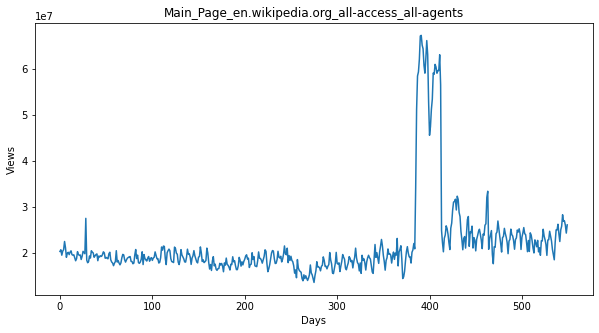

/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12513 (\N{KATAKANA LETTER ME}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12452 (\N{KATAKANA LETTER I}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12531 (\N{KATAKANA LETTER N}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12506 (\N{KATAKANA LETTER PE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-pa

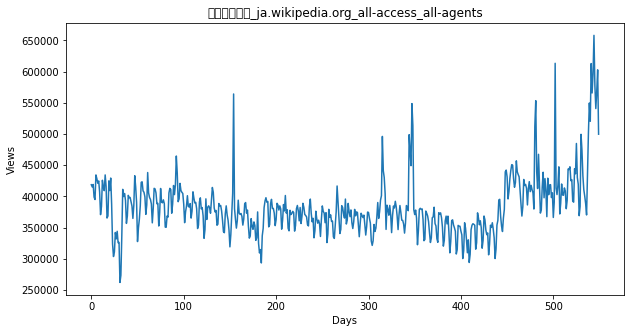

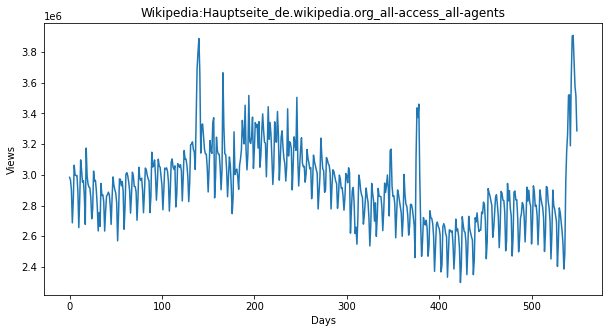

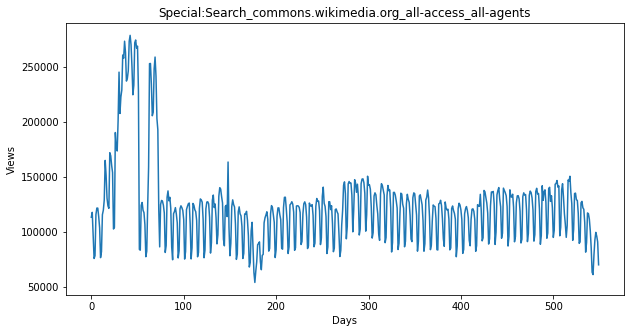

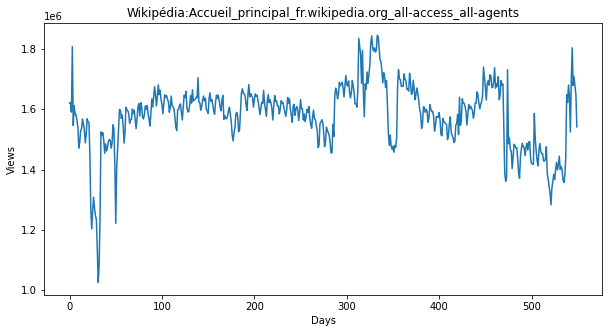

/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39318 (\N{CJK UNIFIED IDEOGRAPH-9996}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39029 (\N{CJK UNIFIED IDEOGRAPH-9875}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


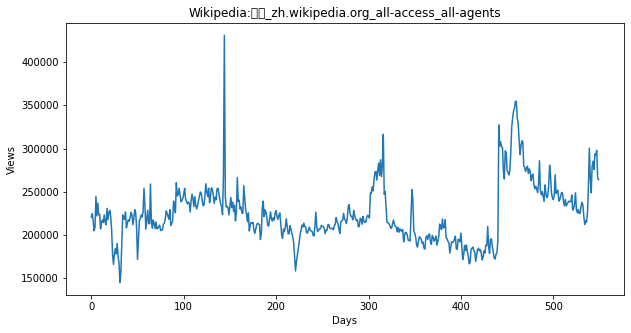

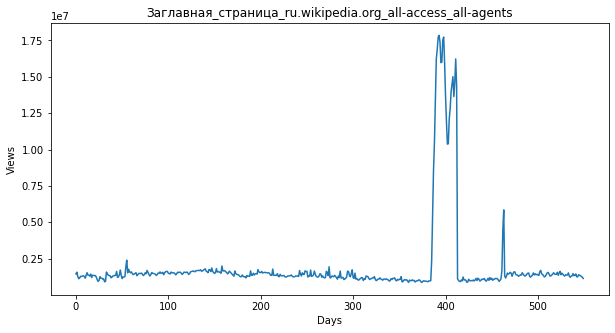

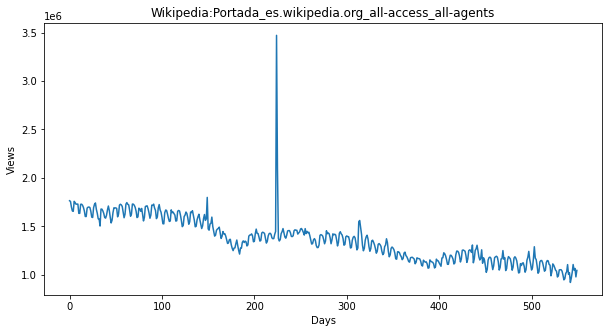

In [15]:
for key in top_pages:
    
    fig=plt.figure(1,figsize=(10,5))
    cols=train.columns
    cols=cols[1:-1]
    data = train.loc[top_pages[key],cols]
    plt.plot(days,data)
    plt.xlabel('Days')
    plt.ylabel('Views')
    plt.title(train.loc[top_pages[key],'Page'])
    plt.show()

## More Analysis Tools

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,


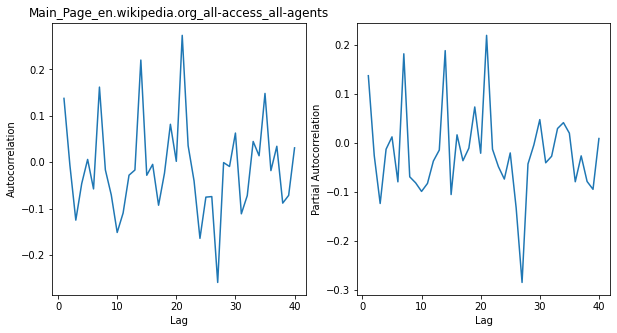

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12513 (\N{KATAKANA LETTER ME}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


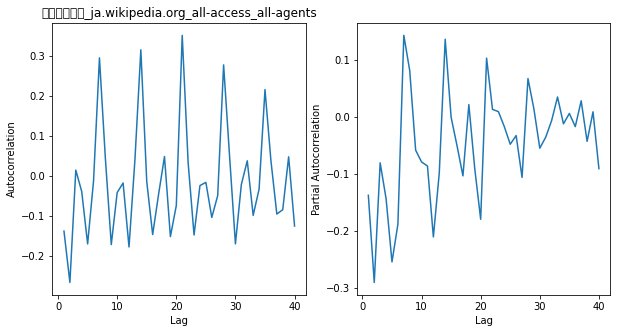

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,


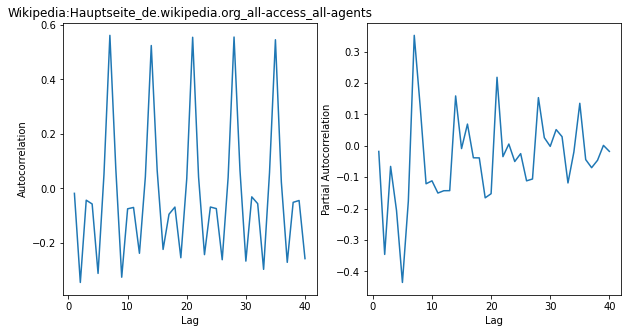

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,


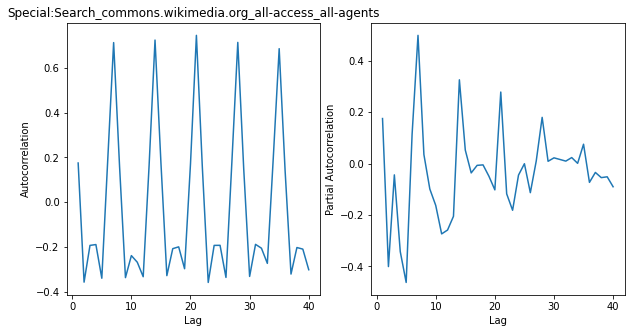

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,


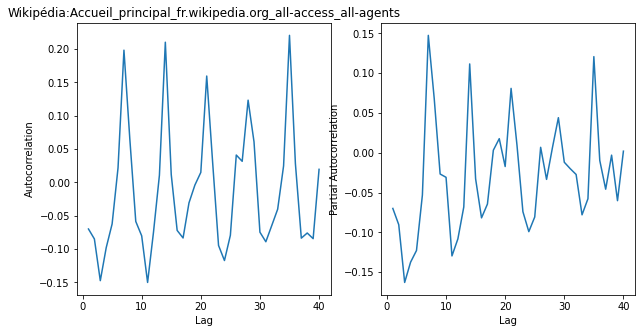

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39318 (\N{CJK UNIFIED IDEOGRAPH-9996}) missing from current font.
  fig.canvas.print_figure(bytes_io

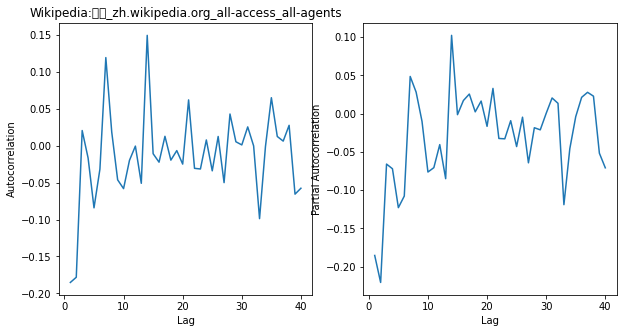

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,


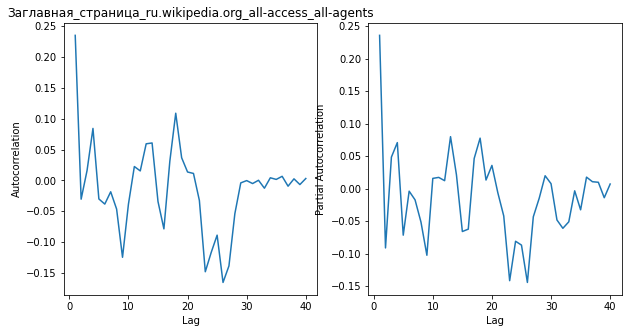

/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:662: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:671: FutureWarning: fft=True will become the default after the release of the 0.12 release of statsmodels. To suppress this warning, explicitly set fft=False.
  FutureWarning,
/opt/conda/lib/python3.7/site-packages/statsmodels/tsa/stattools.py:1029: FutureWarning: The default number of lags is changing from 40 tomin(int(10 * np.log10(nobs)), nobs // 2 - 1) after 0.12is released. Set the number of lags to an integer to  silence this warning.
  FutureWarning,


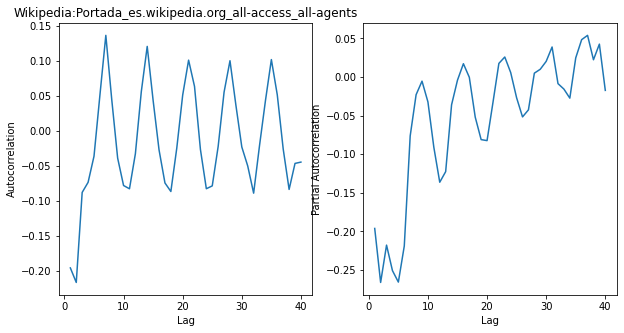

In [16]:
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.stattools import acf

for key in top_pages:
    fig = plt.figure(1,figsize=[10,5])
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    cols = train.columns[1:-1]
    data = np.array(train.loc[top_pages[key],cols])
    data_diff = [data[i] - data[i-1] for i in range(1,len(data))]
    autocorr = acf(data_diff)
    pac = pacf(data_diff)
    
    x = [x for x in range(len(pac))]
    ax1.plot(x[1:],autocorr[1:])
    
    ax2.plot(x[1:],pac[1:])
    ax1.set_xlabel('Lag')
    ax1.set_ylabel('Autocorrelation')
    ax1.set_title(train.loc[top_pages[key],'Page'])
    
    ax2.set_xlabel('Lag')
    ax2.set_ylabel('Partial Autocorrelation')
    plt.show()

## ARIMA Models

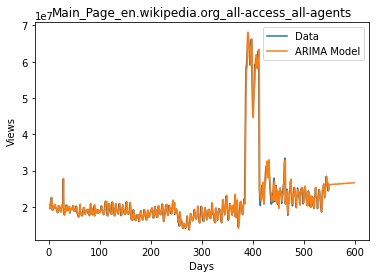

/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12513 (\N{KATAKANA LETTER ME}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12452 (\N{KATAKANA LETTER I}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12531 (\N{KATAKANA LETTER N}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12506 (\N{KATAKANA LETTER PE}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12540 (\N{KATAKANA-HIRAGANA PROLONGED SOUND MARK}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-pa

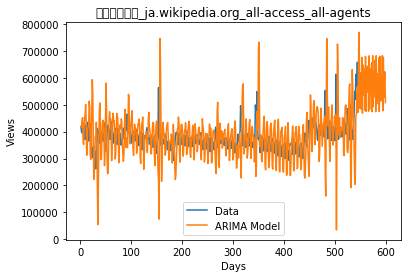

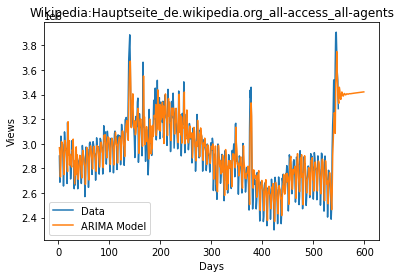

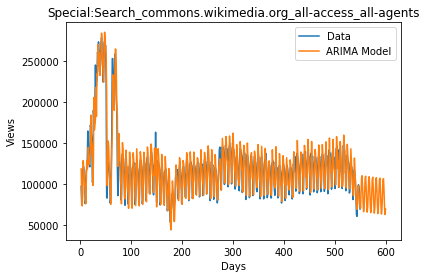

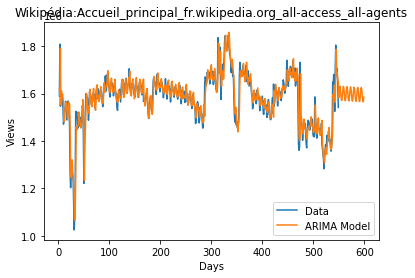

/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39318 (\N{CJK UNIFIED IDEOGRAPH-9996}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/opt/conda/lib/python3.7/site-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39029 (\N{CJK UNIFIED IDEOGRAPH-9875}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


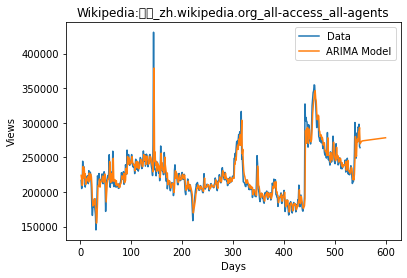

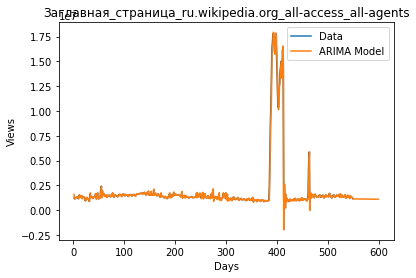

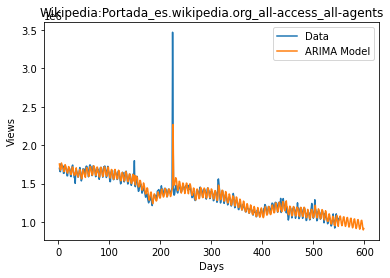

In [17]:
from statsmodels.tsa.arima_model import ARIMA
import warnings

cols = train.columns[1:-1]
for key in top_pages:
    data = np.array(train.loc[top_pages[key],cols],'f')
    result = None
    with warnings.catch_warnings():
        warnings.filterwarnings('ignore')
        try:
            arima = ARIMA(data,[2,1,4])
            result = arima.fit(disp=False)
        except:
            try:
                arima = ARIMA(data,[2,1,2])
                result = arima.fit(disp=False)
                
            except:
                print(train.loc[top_pages[key],'Page'])
                print('\tARIMA failed')
    pred = result.predict(2,599,typ = 'levels')
    x = [i for i in range(600)]
    
    i=0
    
    
    plt.plot(x[2:len(data)],data[2:],label='Data')
    plt.plot(x[2:],pred,label='ARIMA Model')
    plt.title(train.loc[top_pages[key],'Page'])
    plt.xlabel('Days')
    plt.ylabel('Views')
    plt.legend()
    plt.show()
    

## 4 Models

In [18]:
page_details = train.Page.str.extract(r'(?P<topic>.*)\_(?P<lang>.*).wikipedia.org\_(?P<access>.*)\_(?P<type>.*)')

page_details[0:10]

,topic,lang,access,type
0,2NE1,zh,all-access,spider
1,2PM,zh,all-access,spider
2,3C,zh,all-access,spider
3,4minute,zh,all-access,spider
4,52_Hz_I_Love_You,zh,all-access,spider
5,5566,zh,all-access,spider
6,91Days,zh,all-access,spider
7,A'N'D,zh,all-access,spider
8,AKB48,zh,all-access,spider
9,ASCII,zh,all-access,spider


In [19]:
unique_topic = page_details['topic'].unique()
print(unique_topic)
print('Number of Unique Topics: ',len(unique_topic))

['2NE1' '2PM' '3C' ... 'Eine_Reihe_betrüblicher_Ereignisse_(Fernsehserie)'
 'ジャック・リーチャー' 'マイク眞木']
Number of Unique Topics:  42213


In [20]:
print(page_details['access'].unique())
print(page_details['type'].unique())

['all-access' 'desktop' nan 'mobile-web']
['spider' 'all-agents' nan]


Text(0.5, 1.0, 'type - Distribution')

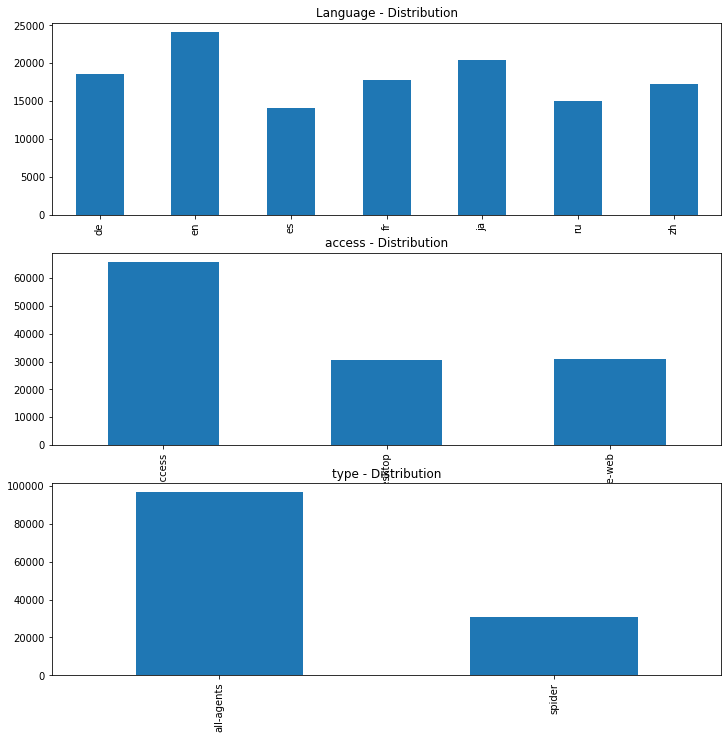

In [21]:
fig,axs = plt.subplots(3,1,figsize=(12,12))

page_details['lang'].value_counts().sort_index().plot.bar(ax=axs[0])
axs[0].set_title('Language - Distribution')

page_details['access'].value_counts().sort_index().plot.bar(ax=axs[1])
axs[1].set_title('access - Distribution')

page_details['type'].value_counts().sort_index().plot.bar(ax=axs[2])
axs[2].set_title('type - Distribution')

## Split into Train and Validation dataset

In [22]:
train_df = pd.concat([page_details,train],axis=1)

def get_train_validate_set(train_df,test_percent):
    train_end = math.floor((train_df.shape[1]-5) * (1-test_percent))
    train_ds = train_df.iloc[:,np.r_[0,1,2,3,4,5:train_end]]
    test_ds = train_df.iloc[:,np.r_[0,1,2,3,4,train_end:train_df.shape[1]]]
    
    return train_ds,test_ds

X_train,y_train = get_train_validate_set(train_df,0.1)
print(X_train.head())
print(y_train.head())

              topic lang      access    type  \
0              2NE1   zh  all-access  spider   
1               2PM   zh  all-access  spider   
2                3C   zh  all-access  spider   
3           4minute   zh  all-access  spider   
4  52_Hz_I_Love_You   zh  all-access  spider   

                                                Page  2015-07-01  2015-07-02  \
0            2NE1_zh.wikipedia.org_all-access_spider        18.0        11.0   
1             2PM_zh.wikipedia.org_all-access_spider        11.0        14.0   
2              3C_zh.wikipedia.org_all-access_spider         1.0         0.0   
3         4minute_zh.wikipedia.org_all-access_spider        35.0        13.0   
4  52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...         NaN         NaN   

   2015-07-03  2015-07-04  2015-07-05  ...  2016-10-23  2016-10-24  \
0         5.0        13.0        14.0  ...        26.0        25.0   
1        15.0        18.0        11.0  ...        25.0        19.0   
2         1.0       

In [23]:
X_train.head()

,topic,lang,access,type,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,...,2016-10-23,2016-10-24,2016-10-25,2016-10-26,2016-10-27,2016-10-28,2016-10-29,2016-10-30,2016-10-31,2016-11-01
0,2NE1,zh,all-access,spider,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,...,26.0,25.0,16.0,19.0,20.0,12.0,19.0,50.0,16.0,30.0
1,2PM,zh,all-access,spider,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,...,25.0,19.0,15.0,21.0,21.0,27.0,33.0,15.0,24.0,13.0
2,3C,zh,all-access,spider,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,...,6.0,5.0,5.0,2.0,3.0,3.0,2.0,2.0,6.0,1.0
3,4minute,zh,all-access,spider,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,...,9.0,13.0,21.0,13.0,10.0,21.0,15.0,103.0,22.0,15.0
4,52_Hz_I_Love_You,zh,all-access,spider,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,NaN,NaN,NaN,NaN,NaN,...,6.0,6.0,4.0,173.0,5.0,10.0,10.0,18.0,20.0,11.0


In [24]:
y_train

,topic,lang,access,type,Page,2016-11-02,2016-11-03,2016-11-04,2016-11-05,2016-11-06,...,2016-12-23,2016-12-24,2016-12-25,2016-12-26,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31,lang
0,2NE1,zh,all-access,spider,2NE1_zh.wikipedia.org_all-access_spider,18.0,25.0,14.0,20.0,8.0,...,63.0,15.0,26.0,14.0,20.0,22.0,19.0,18.0,20.0,zh
1,2PM,zh,all-access,spider,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,26.0,11.0,21.0,...,42.0,28.0,15.0,9.0,30.0,52.0,45.0,26.0,20.0,zh
2,3C,zh,all-access,spider,3C_zh.wikipedia.org_all-access_spider,3.0,3.0,3.0,2.0,10.0,...,1.0,1.0,7.0,4.0,4.0,6.0,3.0,4.0,17.0,zh
3,4minute,zh,all-access,spider,4minute_zh.wikipedia.org_all-access_spider,12.0,11.0,15.0,7.0,12.0,...,10.0,26.0,27.0,16.0,11.0,17.0,19.0,10.0,11.0,zh
4,52_Hz_I_Love_You,zh,all-access,spider,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,5.0,6.0,33.0,13.0,10.0,...,9.0,25.0,13.0,3.0,11.0,27.0,13.0,36.0,10.0,zh
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145058,Underworld_(serie_de_películas),es,all-access,spider,Underworld_(serie_de_películas)_es.wikipedia.o...,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,13.0,12.0,13.0,3.0,5.0,10.0,es
145059,Resident_Evil:_Capítulo_Final,es,all-access,spider,Resident_Evil:_Capítulo_Final_es.wikipedia.org...,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,es
145060,Enamorándome_de_Ramón,es,all-access,spider,Enamorándome_de_Ramón_es.wikipedia.org_all-acc...,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,es
145061,Hasta_el_último_hombre,es,all-access,spider,Hasta_el_último_hombre_es.wikipedia.org_all-ac...,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,es


### Zoupet Predictive analytics with different approaches

### Importation and Data Cleaning

In [25]:
import warnings
import scipy
from datetime import timedelta

# Forecasting with Decomposable Model
from pylab import rcParams
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller

# Fore Machine learning Approach

from statsmodels.tsa.tsatools import lagmat
from sklearn.linear_model import LinearRegression, RidgeCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

#Visualisation
import matplotlib.pyplot as plt
import seaborn as sns

plt.style.use('fivethirtyeight')

warnings.filterwarnings('ignore')


In [26]:
train = pd.read_csv('/kaggle/input/web-traffic-time-series-forecasting/train_1.csv.zip')
train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2016-12-22,2016-12-23,2016-12-24,2016-12-25,2016-12-26,2016-12-27,2016-12-28,2016-12-29,2016-12-30,2016-12-31
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,32.0,63.0,15.0,26.0,14.0,20.0,22.0,19.0,18.0,20.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,17.0,42.0,28.0,15.0,9.0,30.0,52.0,45.0,26.0,20.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,3.0,1.0,1.0,7.0,4.0,4.0,6.0,3.0,4.0,17.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,32.0,10.0,26.0,27.0,16.0,11.0,17.0,19.0,10.0,11.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,48.0,9.0,25.0,13.0,3.0,11.0,27.0,13.0,36.0,10.0


In [27]:
train_flattened = pd.melt(train[list(train.columns[-50:])+['Page']],id_vars='Page',var_name='date',value_name='Visits')
train_flattened['date'] = train_flattened['date'].astype('datetime64[ns]')
train_flattened['weekend'] = ((train_flattened.date.dt.dayofweek)//5 ==1).astype(float)
train_flattened

,Page,date,Visits,weekend
0,2NE1_zh.wikipedia.org_all-access_spider,2016-11-12,13.0,1.0
1,2PM_zh.wikipedia.org_all-access_spider,2016-11-12,12.0,1.0
2,3C_zh.wikipedia.org_all-access_spider,2016-11-12,6.0,1.0
3,4minute_zh.wikipedia.org_all-access_spider,2016-11-12,38.0,1.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,2016-11-12,13.0,1.0
...,...,...,...,...
7253145,Underworld_(serie_de_películas)_es.wikipedia.o...,2016-12-31,10.0,1.0
7253146,Resident_Evil:_Capítulo_Final_es.wikipedia.org...,2016-12-31,NaN,1.0
7253147,Enamorándome_de_Ramón_es.wikipedia.org_all-acc...,2016-12-31,NaN,1.0
7253148,Hasta_el_último_hombre_es.wikipedia.org_all-ac...,2016-12-31,NaN,1.0


In [28]:
train_flattened.shape

(7253150, 4)

In [29]:
df_median = pd.DataFrame(train_flattened.groupby(['Page'])['Visits'].median())
df_median.columns = ['median']

df_mean = pd.DataFrame(train_flattened.groupby('Page')['Visits'].mean())
df_mean.columns = ['mean']

train_flattened = train_flattened.set_index('Page').join(df_mean).join(df_median)

In [30]:
train_flattened.reset_index(drop=False,inplace=True)
train_flattened['weekday'] = train_flattened['date'].apply(lambda x: x.weekday())
train_flattened['year'] = train_flattened.date.dt.year
train_flattened['month'] = train_flattened.date.dt.month
train_flattened['day'] = train_flattened.date.dt.day
train_flattened

,Page,date,Visits,weekend,mean,median,weekday,year,month,day
0,!vote_en.wikipedia.org_all-access_all-agents,2016-11-12,2.0,1.0,2.836735,2.0,5,2016,11,12
1,!vote_en.wikipedia.org_all-access_all-agents,2016-11-13,2.0,1.0,2.836735,2.0,6,2016,11,13
2,!vote_en.wikipedia.org_all-access_all-agents,2016-11-14,4.0,0.0,2.836735,2.0,0,2016,11,14
3,!vote_en.wikipedia.org_all-access_all-agents,2016-11-15,8.0,0.0,2.836735,2.0,1,2016,11,15
4,!vote_en.wikipedia.org_all-access_all-agents,2016-11-16,3.0,0.0,2.836735,2.0,2,2016,11,16
...,...,...,...,...,...,...,...,...,...,...
7253145,［Alexandros］_ja.wikipedia.org_mobile-web_all-a...,2016-12-27,2336.0,0.0,3457.740000,2791.0,1,2016,12,27
7253146,［Alexandros］_ja.wikipedia.org_mobile-web_all-a...,2016-12-28,2455.0,0.0,3457.740000,2791.0,2,2016,12,28
7253147,［Alexandros］_ja.wikipedia.org_mobile-web_all-a...,2016-12-29,3302.0,0.0,3457.740000,2791.0,3,2016,12,29
7253148,［Alexandros］_ja.wikipedia.org_mobile-web_all-a...,2016-12-30,2789.0,0.0,3457.740000,2791.0,4,2016,12,30


## Aggregation and Visualization

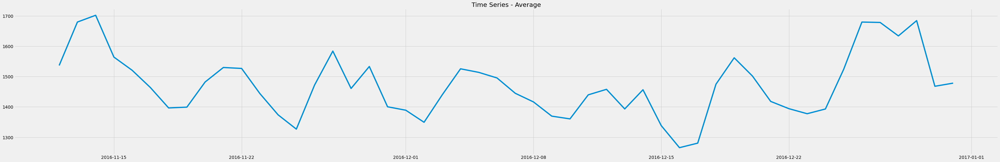

In [31]:
plt.figure(figsize=(50,8))
mean_group = train_flattened[['Page','date','Visits']].groupby(['date'])['Visits'].mean()
plt.plot(mean_group)
plt.title('Time Series - Average')
plt.show()

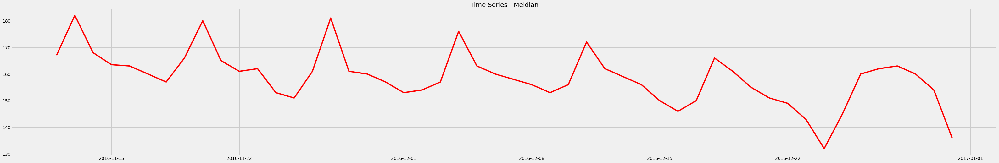

In [32]:
plt.figure(figsize=(50,8))
mean_group = train_flattened[['Page','date','Visits']].groupby(['date'])['Visits'].median()
plt.plot(mean_group,color = 'r')
plt.title('Time Series - Meidian')
plt.show()

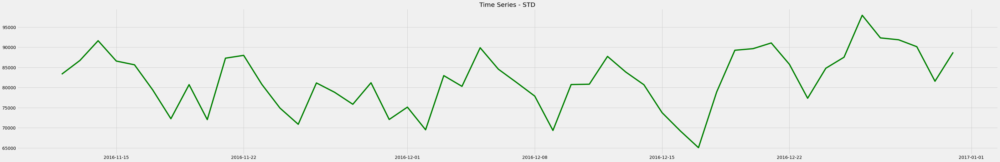

In [33]:
plt.figure(figsize=(50,8))
std_group = train_flattened[['Page','date','Visits']].groupby(['date'])['Visits'].std()
plt.plot(std_group,color = 'g')
plt.title('Time Series - STD')
plt.show()

## ML APPROACH

In [34]:
times_series_means = pd.DataFrame(mean_group).reset_index(drop=False)
times_series_means['weekday'] = times_series_means['date'].apply(lambda x:x.weekday())
times_series_means['Date_str'] = times_series_means['date'].apply(lambda x:str(x))
times_series_means[['year','month','day']] = pd.DataFrame(times_series_means['Date_str'].str.split('-',2).tolist(),columns=['year','month','day'])

date_staging = pd.DataFrame(times_series_means['day'].str.split(' ',2).tolist(),columns=['day','other'])
times_series_means['day'] = date_staging['day']*1
times_series_means.drop('Date_str',axis=1,inplace=True)
times_series_means.head()



,date,Visits,weekday,year,month,day
0,2016-11-12,167.0,5,2016,11,12
1,2016-11-13,182.0,6,2016,11,13
2,2016-11-14,168.0,0,2016,11,14
3,2016-11-15,163.5,1,2016,11,15
4,2016-11-16,163.0,2,2016,11,16


In [35]:
times_series_means.reset_index(drop=True,inplace=True)

def lag_func(data,lag):
    lag = lag
    X = lagmat(data['diff'],lag)
    lagged = data.copy()
    for c in range(1,lag+1):
        lagged['lag%d' %c] = X[:,c-1]
        
    return lagged


def diff_creation(data):
    
    data['diff'] = np.nan
    data.loc[1:,'diff'] = (data.iloc[1:,1].values - data.iloc[:len(data)-1,1].values)
    return data

df_count = diff_creation(times_series_means)

lag = 7
lagged = lag_func(df_count,lag)
last_date = lagged['date'].max()

In [36]:
lagged.head()


,date,Visits,weekday,year,month,day,diff,lag1,lag2,lag3,lag4,lag5,lag6,lag7
0,2016-11-12,167.0,5,2016,11,12,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2016-11-13,182.0,6,2016,11,13,15.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0
2,2016-11-14,168.0,0,2016,11,14,-14.0,15.0,NaN,0.0,0.0,0.0,0.0,0.0
3,2016-11-15,163.5,1,2016,11,15,-4.5,-14.0,15.0,NaN,0.0,0.0,0.0,0.0
4,2016-11-16,163.0,2,2016,11,16,-0.5,-4.5,-14.0,15.0,NaN,0.0,0.0,0.0


In [37]:
def train_test(data_lag):
    xc = ['lag%d' % i for i in range(1,lag+1)] + ['weekday'] +['day']
    split = 0.70
    xt = data_lag[(lag+1):][xc]
    yt = data_lag[(lag+1):]['diff']
    isplit = int(len(xt) * split)
    x_train,y_train,x_test,y_test = xt[:isplit],yt[:isplit],xt[isplit:],yt[isplit:]
    return x_train,y_train,x_test,y_test,xt,yt

x_train,y_train,x_test,y_test,xt,yt = train_test(lagged)

In [38]:
from sklearn.ensemble import ExtraTreesRegressor,GradientBoostingRegressor, BaggingRegressor,AdaBoostRegressor

from sklearn.metrics import mean_absolute_error, r2_score

def modelisation(x_tr,y_tr,x_ts,y_ts,xt,yt,model0,model1):
    model0.fit(x_tr,y_tr)
    
    prediction = model0.predict(x_ts)
    r2 = r2_score(y_ts.values,model0.predict(x_ts))
    mae = mean_absolute_error(y_ts.values,model0.predict(x_ts))
    print('mae with 70% data',mae)
    
    model1.fit(xt,yt)#with all data
    
    return model1,prediction,model0

model0 = AdaBoostRegressor(n_estimators=5000,random_state=42,learning_rate=0.01)
model1 = AdaBoostRegressor(n_estimators=5000,random_state=42,learning_rate=0.01)

clr,prediction,clr0 = modelisation(x_train,y_train,x_test,y_test,xt,yt,model0,model1)

mae with 70% data 8.112912087912088


In [46]:
def pred_df(data,number_of_days):
    data_pred = pd.DataFrame(pd.Series(data['date'][data.shape[0]-1] + timedelta(days=1)),columns = ['date'])
    for i in range(number_of_days):
        inter = pd.DataFrame(pd.Series(data['date'][data.shape[0]-1] + timedelta(days=i+2)),columns=['date'])
        
        date_pred = pd.concat([data_pred,inter]).reset_index(drop=True)
        
    return data_pred

data_to_pred = pred_df(df_count,30)
data_to_pred

,date
0,2017-01-01


In [49]:
def initialisation(data_lag,data_pred,model,xtrain,ytrain,number_of_days):
    
    model.fit(xtrain,ytrain)
    
    for i in range(number_of_days):
        lag1 = data_lag.tail(1)['diff'].values[0]
        lag2 = data_lag.tail(1)['lag1'].values[0]
        lag3 = data_lag.tail(1)['lag2'].values[0]
        lag4 = data_lag.tail(1)['lag3'].values[0]
        lag5 = data_lag.tail(1)['lag4'].values[0]
        lag6 = data_lag.tail(1)['lag5'].values[0]
        lag7 = data_lag.tail(1)['lag6'].values[0]
        lag8 = data_lag.tail(1)['lag7'].values[0]
        
        data_pred['weekday'] = data_pred['date'].apply(lambda x:x.weekday)
        weekday = data_pred['weekday'][0]
        
        row = pd.Series([lag1,lag2,lag3,lag4,lag5,lag6,lag7,lag8,weekday],
                       ['lag1','lag2','lag3','lag4','lag5','lag6','lag7','lag8','weekday'])
        
        to_predict = pd.DataFrame(columns=['lag1','lag2','lag3','lag4','lag5','lag6','lag7','lag8','weekday'])
        
        prediction = pd.DataFrame(columns=['diff'])
        to_predict = to_predict.append([row])
        prediction = pd.DataFrame(model.predict(to_predict),columns=['diff'])
        
        if i == 0:
            last_predict = data_lag['Visits'][data_lag.shape[0]-1] + prediction.values[0][0]
            
        if i > 0 :
            
            last_predict = data_lag['Visits'][data_lag.shape[0]-1] + prediction.values[0][0]
            
        data_lag = pd.concat([data_lag,prediction.join(data_pred['date']).join(to_predict)]).reset_index(drop=True)
        
        data_lag['Visits'][data_lag.shape[0]-1] = last_predict
        
        #test
        data_pred = data_pred[data_pred['date']>data_pred['date'][0]].reset_index(drop=True)
        
    
    
    return data_lag


model_fin = AdaBoostRegressor(n_estimators=5000,random_state=42,learning_rate=0.01)


        
        

In [50]:
lagged = initialisation(lagged,data_to_pred,model_fin,xt,yt,30)

TypeError: float() argument must be a string or a number, not 'builtin_function_or_method'

In [56]:
model_fin = AdaBoostRegressor(n_estimators=5000,random_state=42,learning_rate=0.01)

In [2]:
model_fin.fit(xt,yt)
    
for i in range(30):
    lag1 = lagged.tail(1)['diff'].values[0]
    lag2 = lagged.tail(1)['lag1'].values[0]
    lag3 = lagged.tail(1)['lag2'].values[0]
    lag4 = lagged.tail(1)['lag3'].values[0]
    lag5 = lagged.tail(1)['lag4'].values[0]
    lag6 = lagged.tail(1)['lag5'].values[0]
    lag7 = lagged.tail(1)['lag6'].values[0]
    lag8 = lagged.tail(1)['lag7'].values[0]
        
    data_to_pred['weekday'] = data_to_pred['date'].apply(lambda x:x.weekday)
    weekday = data_to_pred['weekday'][0]
        

NameError: name 'model_fin' is not defined

In [6]:
train.shape

(145063, 551)

In [7]:
df_eda = train.iloc[:2000,:50]
df_eda.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2015-08-09,2015-08-10,2015-08-11,2015-08-12,2015-08-13,2015-08-14,2015-08-15,2015-08-16,2015-08-17,2015-08-18
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,10.0,5.0,9.0,9.0,9.0,9.0,13.0,4.0,15.0,25.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,12.0,27.0,27.0,36.0,23.0,58.0,80.0,60.0,69.0,42.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,4.0,5.0,0.0,0.0,7.0,3.0,5.0,1.0,6.0,2.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,8.0,27.0,19.0,16.0,2.0,84.0,22.0,14.0,47.0,25.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
df_eda.shape

(2000, 50)

In [10]:
from dataprep import eda as dp_eda

/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infav

  0%|          | 0/12751 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infavour of `both` or `neither`.
  return getattr(obj, self.method)(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/dask/utils.py:893: FutureWarning: Boolean inputs to the `inclusive` argument are deprecated infav

DataPrep Report
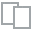
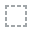
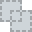
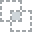
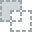
...
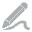
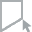
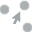
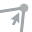
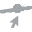

In [11]:
report = dp_eda.create_report(df_eda)
report